In [4]:
import sys
import os
import os.path as osp
import argparse
import numpy as np
import cv2
import json
import torch
from glob import glob
from tqdm import tqdm
import torchvision.transforms as transforms
from torch.nn.parallel.data_parallel import DataParallel
import torch.backends.cudnn as cudnn

sys.path.insert(0, osp.join('..', 'main'))
sys.path.insert(0, osp.join('..', 'data'))
sys.path.insert(0, osp.join('..', 'common'))
from config import cfg
from model_new import get_model
from utils.preprocessing import load_img, process_bbox, generate_patch_image, get_iou
from utils.vis import vis_keypoints_with_skeleton, save_obj, render_mesh_orthogonal
from utils.mano import mano

Fix shapedirs bug of MANO


In [3]:
from adabn_utils import compute_bn_stats, replace_bn_stats

In [5]:
cfg.set_args("0")
cudnn.benchmark = True

model_path = r"C:\Users\vladi\RP\InterWild\demo\snapshot_6.pth"
assert osp.exists(model_path), 'Cannot find model at ' + model_path
print('Load checkpoint from {}'.format(model_path))
model = get_model('test')
model = DataParallel(model).cuda()
ckpt = torch.load(model_path)
model.load_state_dict(ckpt['network'], strict=False)
model.eval()


>>> Using GPU: 0
Load checkpoint from C:\Users\vladi\RP\InterWild\demo\snapshot_6.pth


C:\Users\vladi\AppData\Local\Temp\ipykernel_35584\3866305133.py:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(model_path)


DataParallel(
  (module): Model(
    (body_backbone): ResNetBackbone(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu

In [8]:
cfg.input_hand_shape

(256, 256)

In [9]:
print(hand_feat[0].shape, hand_feat[1].shape, hand_feat[2].shape)

torch.Size([2, 2048, 8, 8]) torch.Size([2, 2, 3]) torch.Size([2, 2, 3])


In [6]:
len(hand_feat)

3

In [16]:
ir_image_dir = r"C:\Users\vladi\RP\our_hands_dataset_labeled_previews\RGB"
ir_image_paths = glob(osp.join(ir_image_dir, "*.jpg"))  # Assuming images are in .jpg forma
# Create a custom dataset for your infrared images
# Create a custom dataset for your infrared images
class InfraredDataset(torch.utils.data.Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]

        # Load and preprocess the image using InterWild's functions
        original_img = load_img(img_path)
        img_height, img_width = original_img.shape[:2]
        bbox = [0, 0, img_width, img_height]  # Use the entire image as the initial bbox
        bbox = process_bbox(bbox, img_width, img_height)
        img, img2bb_trans, bb2img_trans = generate_patch_image(original_img, bbox, 1.0, 0.0, False, cfg.input_img_shape)

        if self.transform:
            img = self.transform(img.astype(np.float32)) / 255
        
        return img

# Define transformations (match demo.py preprocessing)
transform = transforms.Compose([
    transforms.ToTensor(),
])

# Create dataset and dataloader
ir_dataset = InfraredDataset(ir_image_paths, transform=transform)
ir_dataloader = torch.utils.data.DataLoader(ir_dataset, batch_size=1, shuffle=True, num_workers=0)

In [17]:
from adabn_utils import compute_bn_stats, replace_bn_stats, BatchNormStatHook
import os
os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'

import random
import sys
import numpy as np

import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import Dataset
from functools import partial

In [5]:
model.eval()
# Set BatchNorm layers to training mode
# Iterate through the dataloader
hook = BatchNormStatHook()

with torch.no_grad():
    for name, module in model.named_modules():
        if isinstance(module, torch.nn.BatchNorm2d):
            module.train()
            hook_handle = module.register_forward_hook(partial(hook, name=name))
            hook.hooks.append(hook_handle)

NameError: name 'BatchNormStatHook' is not defined

In [6]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
with torch.no_grad():
    for data in tqdm(rd_dataloader):

        inputs = {'img': data[0].to(device)}
        targets = {}
        meta_info = {}
        # Forward pass (hook will accumulate statistics)
        model(inputs, targets, meta_info, "test")

NameError: name 'rd_dataloader' is not defined

In [14]:
for layer_name, stats in hook.bn_stats.items():
        # Average the accumulated statistics
        mean = stats['mean'] / stats['count']
        var = stats['var'] / stats['count']
        hook.bn_stats[layer_name] = {'mean': mean, 'var': var}

In [15]:
hook.unhook()

In [16]:
# Open file to save prints
with open('bn_stats_output.txt', 'w') as f:
    # Redirect prints to file
    import sys
    original_stdout = sys.stdout
    sys.stdout = f
    
    replace_bn_stats(model, hook.bn_stats, ratio=0.5)
    sys.stdout = original_stdout

In [9]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [21]:
cfg.input_body_shape

(256, 192)

In [32]:
model.eval()

# Example inference (adapted from demo.py)
mesh_save_path = './meshes'
param_save_path = './params'
render_save_path = './renders'
os.makedirs(mesh_save_path, exist_ok=True)
os.makedirs(param_save_path, exist_ok=True)
os.makedirs(render_save_path, exist_ok=True)

# for each input image
i = 0
dest = "DEEPCoral_IR_1"
os.makedirs("renders/" + dest, exist_ok=True)
for img_path in tqdm(ir_image_paths[10:]):
    i += 1
    file_name = img_path.split('/')[-1][:-4]
    
    # load image and make its aspect ratio follow cfg.input_img_shape
    original_img = load_img(img_path) 
    img_height, img_width = original_img.shape[:2]
    bbox = [0, 0, img_width, img_height]
    bbox = process_bbox(bbox, img_width, img_height)
    img, img2bb_trans, bb2img_trans = generate_patch_image(original_img, bbox, 1.0, 0.0, False, cfg.input_img_shape)
    transform = transforms.ToTensor()
    img = transform(img.astype(np.float32))/255
    img = img.cuda()[None,:,:,:]
    print(img.shape)
    # forward to InterWild
    inputs = {'img': img}
    targets = {}
    meta_info = {}
    with torch.no_grad():
        out = model(inputs, targets, meta_info, 'test')
    print(out.keys())
    print(out["rhand_bbox"])
    
    # Draw bounding boxes on image
    vis_img = np.ascontiguousarray(original_img.copy())

    scale_x = img_width / cfg.input_body_shape[1]  
    scale_y = img_height / cfg.input_body_shape[0]  

    # Draw right hand bbox
    if 'rhand_bbox' in out:
        rhand_bbox = out['rhand_bbox'].cpu().numpy()[0]
        # Scale the coordinates back to original image dimensions
        x1, y1, x2, y2 = rhand_bbox
        x1 = x1 * scale_x
        x2 = x2 * scale_x
        y1 = y1 * scale_y
        y2 = y2 * scale_y
        cv2.rectangle(vis_img, (int(x1), int(y1)), (int(x2), int(y2)), (255,0,0), 2)

    # Draw left hand bbox 
    if 'lhand_bbox' in out:
        lhand_bbox = out['lhand_bbox'].cpu().numpy()[0]
        # Scale the coordinates back to original image dimensions
        x1, y1, x2, y2 = lhand_bbox
        x1 = x1 * scale_x
        x2 = x2 * scale_x
        y1 = y1 * scale_y
        y2 = y2 * scale_y
        cv2.rectangle(vis_img, (int(x1), int(y1)), (int(x2), int(y2)), (0,255,0), 2)

    """
    vis_skeleton = original_img.copy()[:,:,::-1]
    for h in ('right', 'left'):
        # get outputs
        joint_img = out["source_" + h[0] + 'joint_img'].cpu().numpy()[0] # 2.5D pose
            # 2D skeleton
        joint_img_xy1 = np.concatenate((joint_img[:,:2], np.ones_like(joint_img[:,:1])),1)
        joint_img = np.dot(bb2img_trans, joint_img_xy1.transpose(1,0)).transpose(1,0)
        print(joint_img)
        if h == 'right':
            color = (255,0,255) # purple
        else:
            color = (102,255,102) # green
            
        vis_skeleton = vis_keypoints_with_skeleton(vis_skeleton, joint_img, mano.sh_skeleton, color)
        print("hello")
        # save mesh
        #save_obj(mesh, mano.face[h], osp.join(mesh_save_path, file_name + '_' + h + '.obj'))

        # save MANO parameters
      
    # save box
    #cv2.imwrite(osp.join(render_save_path, file_name + '_box.jpg'), vis_box)

    # save 2D skeleton
    
    cv2.imwrite(f"renders/{dest}/img_{i}.jpg", vis_skeleton)
    print("saved ", f"renders/{dest}/img_{i}.jpg")
    """
    
    break    

  0%|          | 0/70 [00:00<?, ?it/s]

torch.Size([1, 3, 512, 384])


  0%|          | 0/70 [00:00<?, ?it/s]

dict_keys(['img', 'rhand_bbox', 'lhand_bbox', 'rhand_bbox_conf', 'lhand_bbox_conf', 'rjoint_img', 'ljoint_img'])
tensor([[ 78.5545,  97.4123, 122.5345, 131.5158]], device='cuda:0')


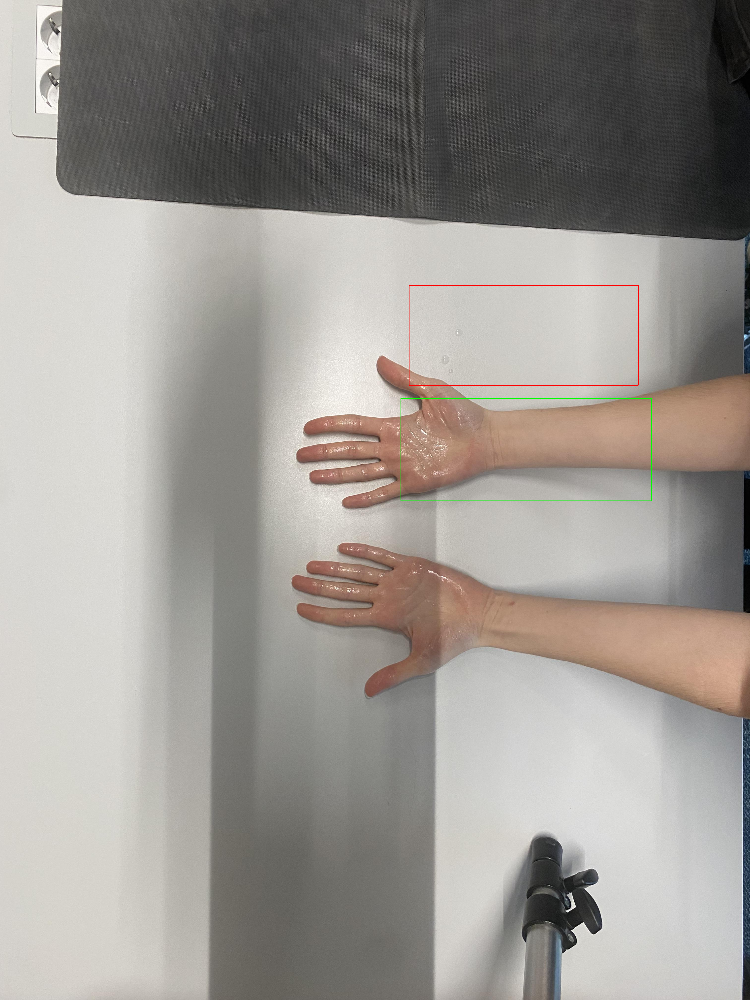

In [33]:
from PIL import Image
Image.fromarray(vis_img.astype(np.uint8))

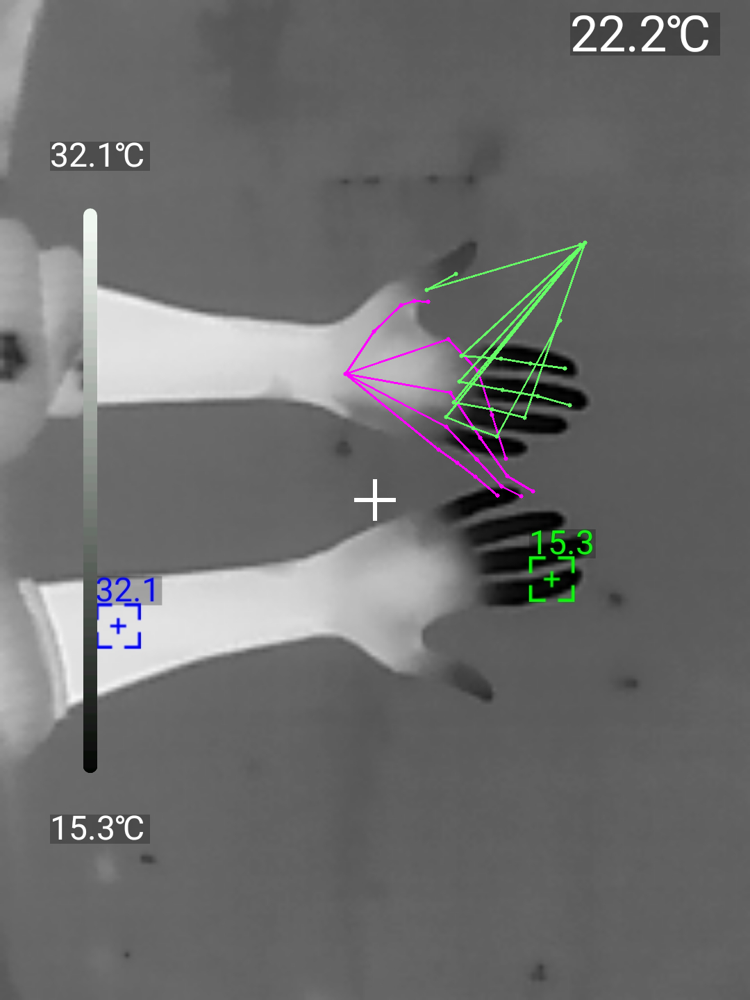

In [10]:
from PIL import Image
Image.fromarray(vis_skeleton.astype(np.uint8))


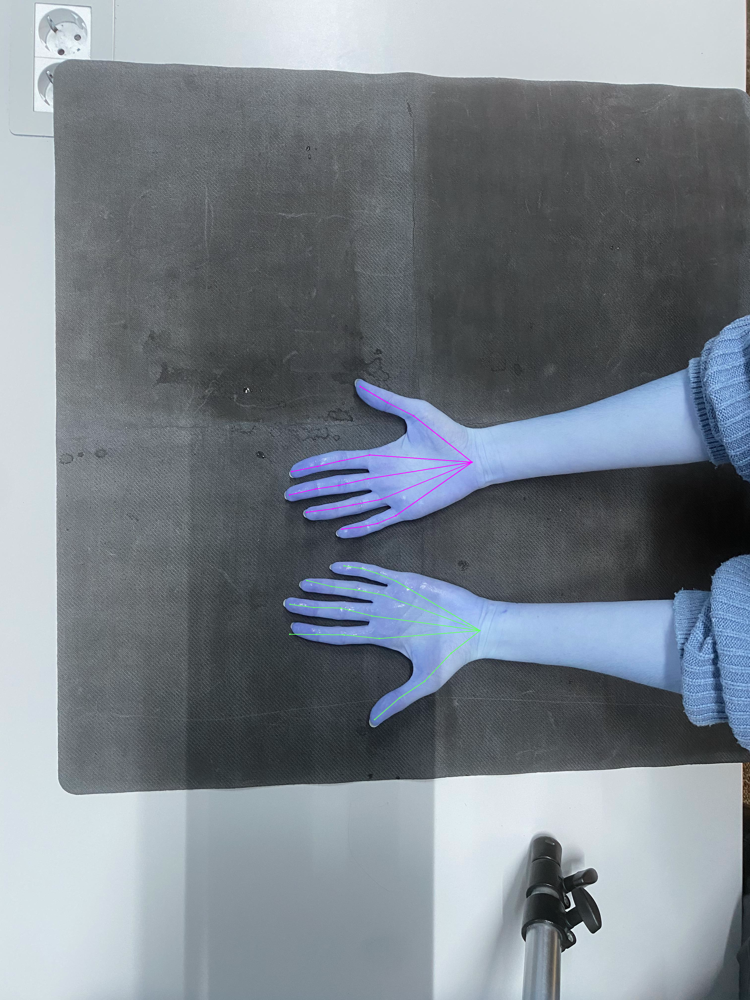

In [8]:
from PIL import Image
Image.fromarray(vis_skeleton.astype(np.uint8))

In [9]:
out.keys()

dict_keys(['source_img', 'source_rhand_bbox', 'source_lhand_bbox', 'source_rhand_bbox_conf', 'source_lhand_bbox_conf', 'source_rjoint_img', 'source_ljoint_img', 'target_img', 'target_rhand_bbox', 'target_lhand_bbox', 'target_rhand_bbox_conf', 'target_lhand_bbox_conf', 'target_rjoint_img', 'target_ljoint_img'])

In [16]:
out['source_rjoint_img']


tensor([[[2.0000, 2.0000, 4.0000],
         [2.0000, 2.0000, 5.0000],
         [2.1125, 2.1067, 4.8560],
         [3.5136, 2.5334, 3.6028],
         [3.9996, 2.1598, 3.5363],
         [3.7918, 3.8683, 3.3338],
         [4.5375, 3.9228, 3.5782],
         [4.9843, 3.9719, 3.8376],
         [5.4156, 4.0213, 4.1372],
         [3.8608, 4.3357, 3.5793],
         [4.5567, 4.3884, 3.9662],
         [4.9811, 4.4037, 4.3575],
         [5.4673, 4.4974, 4.6739],
         [3.6705, 4.7294, 3.9175],
         [4.3034, 4.7109, 4.1859],
         [4.7261, 4.6631, 4.6214],
         [5.1809, 4.7038, 4.9100],
         [3.4344, 4.9686, 4.2478],
         [3.8643, 5.0326, 4.4686],
         [4.1856, 4.9603, 4.7813],
         [4.6212, 4.9112, 5.0251]]], device='cuda:0')

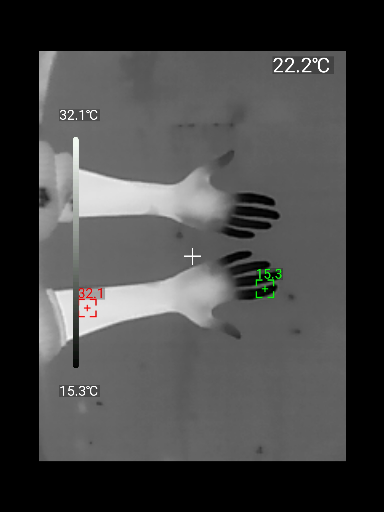

In [14]:
from PIL import Image
import torchvision.transforms.functional as TF

# Convert tensor to PIL Image
img_tensor = out['source_img'].squeeze(0).cpu() # Remove batch dimension and move to CPU
img_pil = TF.to_pil_image(img_tensor)
img_pil

In [10]:
out["source_rhand_bbox"]

tensor([[ 87.1887,  79.2651, 144.1712, 122.9666]], device='cuda:0')

In [5]:
from researchdataset import VideoDataset
video_directory = "C:/Users/vladi/RP/Research/IR_videos"  # Replace with your directory
dataset = VideoDataset(video_directory, transform=None, frame_skip=40)


Loading videos: 100%|██████████| 8/8 [10:14<00:00, 76.75s/it]


In [6]:
def preprocess_image(image_array):
    # Process bbox
    bbox = [0, 0, image_array.shape[1], image_array.shape[0]]  # Use entire image
    bbox = process_bbox(bbox, image_array.shape[1], image_array.shape[0])
    
    # Generate patch image
    img, img2bb_trans, bb2img_trans = generate_patch_image(image_array, bbox, 1.0, 0.0, False, cfg.input_img_shape)
    
    # Transform and normalize
    transform = transforms.ToTensor()
    img = transform(img.astype(np.float32))/255
    img = img.cuda()
    
    return img


In [7]:
for i in tqdm(range(len(dataset.data))):
   processed_frame = preprocess_image(dataset.data[i])
   if processed_frame is not None:
       dataset.data[i] = processed_frame

100%|██████████| 2473/2473 [00:31<00:00, 77.68it/s] 


In [8]:
rd_dataloader = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=True, num_workers=0)

In [28]:
# Open file to save prints
with open('bn_stats_output.txt', 'w') as f:
    # Redirect prints to file
    import sys
    original_stdout = sys.stdout
    sys.stdout = f
    
    initial_bn_stats, bn_stats = compute_bn_stats(model, rd_dataloader)
    replace_bn_stats(model, bn_stats)
    
    # Restore original stdout
    sys.stdout = original_stdout

100%|██████████| 52/52 [00:09<00:00,  5.55it/s]


Make inference with a model and save to json

In [11]:
def normalize_coords(x, y, img_width, img_height):
   return {
       "x": float(x) / img_width,
       "y": float(y) / img_height
   }


In [12]:
predictions = []
# Process each image
model.eval()
for img_path in ir_image_paths:
   # Load and process image (your existing code)
   original_img = load_img(img_path)
   img_height, img_width = original_img.shape[:2]
   bbox = [0, 0, img_width, img_height]
   bbox = process_bbox(bbox, img_width, img_height)
   img, img2bb_trans, bb2img_trans = generate_patch_image(original_img, bbox, 1.0, 0.0, False, cfg.input_img_shape)
   transform = transforms.ToTensor()
   img = transform(img.astype(np.float32))/255
   img = img.cuda()[None,:,:,:]
    # Forward pass
   inputs = {'img': img}
   targets = {}
   meta_info = {}
   with torch.no_grad():
       out = model(inputs, {'img': img.clone()}, targets, meta_info, 'test')
    # Get predictions for both hands
   prediction = {
       "image": os.path.basename(img_path),
       "width": int(img_width),
       "height": int(img_height),
       "landmarks": [],
       "normalized": True
   }
   
   for hand in ('right', 'left'):
       # Get joint coordinates
       joint_img = out["source_" + hand[0] + 'joint_img'].cpu().numpy()[0]
       joint_img_xy1 = np.concatenate((joint_img[:,:2], np.ones_like(joint_img[:,:1])),1)
       joint_img = np.dot(bb2img_trans, joint_img_xy1.transpose(1,0)).transpose(1,0)
       
       # Normalize and format coordinates
       hand_points = []
       for point in joint_img:
           hand_points.append(normalize_coords(point[0], point[1], img_width, img_height))
       
       prediction["landmarks"].append(hand_points)
   
   predictions.append(prediction)

In [13]:
len(predictions)

80

In [14]:
output_path = 'predictions_IW_DEEPCoral_IR_1.json'
with open(output_path, 'w') as f:
   json.dump(predictions, f, indent=2)
print(f"Predictions saved to {output_path}")

Predictions saved to predictions_IW_DEEPCoral_IR_1.json


In [3]:
from custom_eval_framework import HandLandmarksDataset
dataset = HandLandmarksDataset(image_dir=r"C:\Users\vladi\RP\our_hands_dataset_labeled_previews\IR", annotations_path=r"C:\Users\vladi\RP\our_hands_dataset_labeled_previews\combined_FIX_IR.json")


In [4]:
out = dataset.perform_evaluation(model)

In [5]:
print(out)

EvaluationReport:
PCK:
  Mean: 0.376
  Min:  0.000
  Max:  1.000
  Count: 80
